<a href="https://colab.research.google.com/github/AfifahNofa/PCVK_Ganjil_2022/blob/main/TI_3B_03_Afifah_Nofa_Modul5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**JOBSHEET 5**

Operasi Aritmatika dan Logika - Gamma Correction,
Image Depth, PSNR, Average Denoising, Image Masking


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


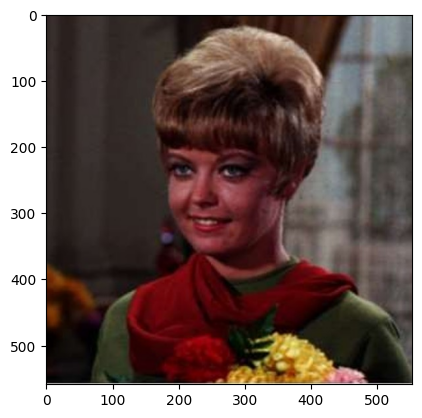

In [4]:
import cv2 as cv
from google.colab.patches import cv2_imshow
from skimage import io
import matplotlib.pyplot as plt
import numpy as np

img_f = cv.imread('/content/drive/MyDrive/PCVK/Images/female.tiff')
img_rgb = cv.cvtColor(img_f,cv.COLOR_BGR2RGB) # konversi channel BGR -> RGB
plt.imshow(img_rgb)

**Tugas Praktikum**
1.	Buat Gamma Correction sesuai dengan petunjuk berikut
Percobaan ini akan meminta anda membuat Gamma Correction. Pada percobaan ini, nilai Gamma akan diset dengan meminta masukan dari pengguna. Berikut adalah kode untuk meminta masukan nilai dari pengguna. Lanjutkan kode tersebut dengan membuat image dengan gamma correction sesuai rumus yang telah diberikan.


 Gamma Correction pada citra 
----------------------------------
Masukkan nilai Gamma: 3


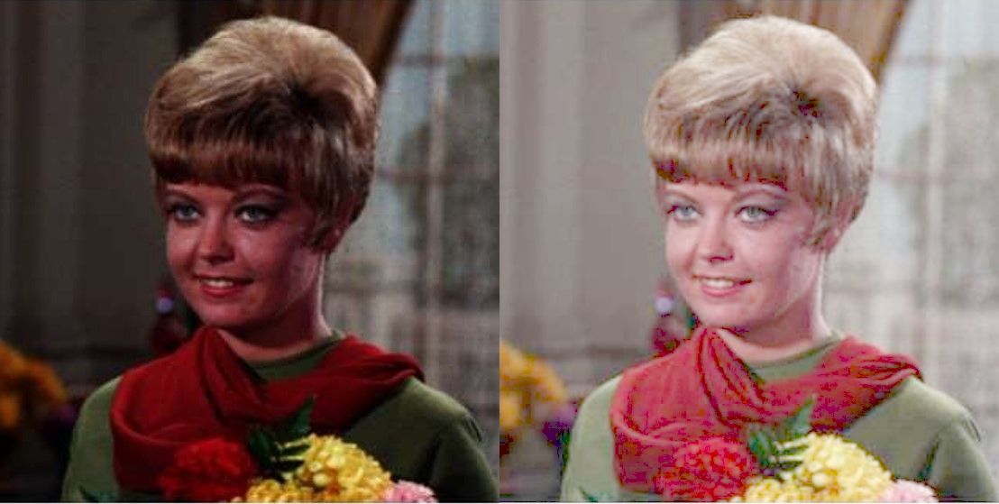

In [6]:
#mencetak judul dan garis pemisah
print(' Gamma Correction pada citra ')
print('----------------------------------')
#meminta input nilai gamma dari pengguna
try:
  gamma = int(input('Masukkan nilai Gamma: '))
except ValueError:
  print('Error, not a number')
#mendeklarasikan variabel original dan gamma_image
original = cv.cvtColor(img_rgb,cv.COLOR_BGR2RGB) #digunakan untuk menyimpan citra asli
gamma_image = np.zeros(original.shape, original.dtype) #digunakan untuk menyimpan citra hasil koreksi gamma

#loop untuk menghitung nilai piksel baru pada citra hasil koreksi gamma
for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    for c in range(original.shape[2]):
      #setiap piksel pada citra asli diubah menjadi piksel baru menggunakan rumus dibawah ini, kemudian disimpan dalam variabel gamma_image
     gamma_image[y,x,c] = np.clip(255 * pow(original[y,x,c] / 255, (1 / gamma)), 0, 255)
#menggabungkan citra asli dan citra hasil koreksi gamma secara horizontal menggunakan fungsi cv.hconcat()
final_frame = cv.hconcat((original, gamma_image))
#untuk menampilkan hasil
cv2_imshow(final_frame)

2.	Buat Simulasi Image Depth
Percobaan ini digunakan sebagai simulasi dari proses kuantisasi citra. Pada kuantisasi citra, pixel dapat direpresentasikan dengan n-bit kedalaman (default menggunakan 8-bit). Pada pixel 8-bit, warna yang memungkinkan adalah 256 warna, dari 0 (0000 0000) hingga
255(1111 1111). Pada pixel 7-bit, warna yang memungkinkan adalah 128 warna, dari 0 (000
0000) hingga 127 (111 1111). Kemungkinan warna didapat dari pangkat 2 jumlah bit. Jika 7bit, maka jumlah warnanya adalah 27 = 128, dst.
Berikut adalah kode untuk membaca citra masukan dan memberi nilai kedalaman citra, silahkan lanjutkan kode program berikut sehingga menghasilkan keluaran seperti contoh pada Gambar.


 Simulasi Image Depth 
----------------------
Masukkan nilai bit depth: 3


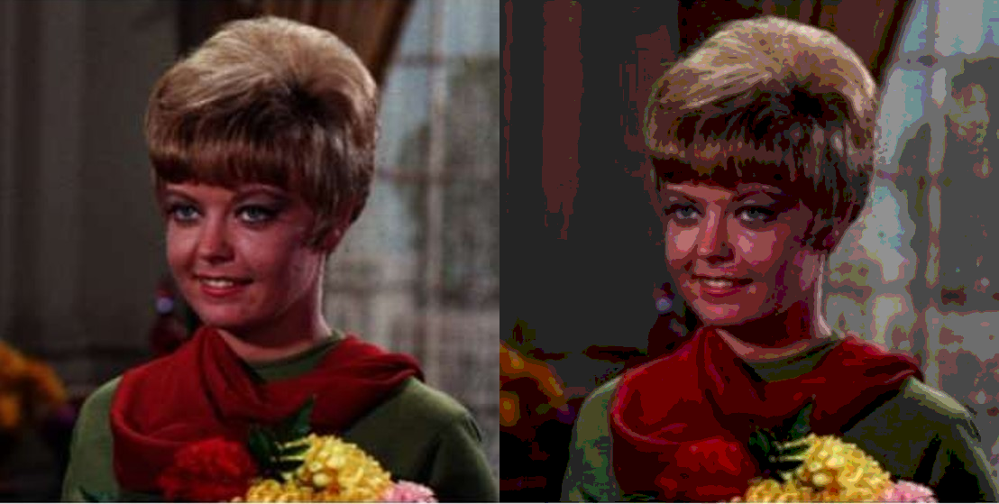

In [7]:
#membuat variabel untuk menyimpan citra asli
original = cv.cvtColor(img_rgb,cv.COLOR_BGR2RGB)
#membuat variabel untuk menyimpan citra hasil simulasi kedalaman
gamma_image = np.zeros(original.shape, original.dtype)

print(' Simulasi Image Depth ')
print('----------------------')
#meminta input nilai bit depth dari pengguna
try:
  bd = float(input('Masukkan nilai bit depth: '))
except ValueError:
  print('Error, not a number')

#untuk menghitung jumlah bit dan level intensitas warna berdasarkan nilai yang diinputkan pengguna
bit = 2**bd
level = 255 / (bit - 1)
#loop untuk menghitung nilai intensitas warna baru pada citra hasil simulasi kedalaman
for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    for c in range(original.shape[2]):
      #menyimpan hasil dari setiap piksel pada citra asli yang diubah menjadi nilai intensitas warna baru
     gamma_image[y,x,c] = np.clip(round(original[y,x,c] / level) * level, 0, 255);
#untuk menggabungkan citra asli dan citra hasil simulasi kedalaman secara horizontal
final_frame = cv.hconcat((original, gamma_image))
#menampilkan hasil
cv2_imshow(final_frame)

3.	Buat modul Average Denoising
Buat modul average denoising sesuai dengan rumus yang telah diberikan pada sub bab sebelumnya.
Citra asli sudah disediakan pada /images/galaxy.jpg.
100 Citra dengan Gaussian Noise sudah disediakan pada /images/noises/*.jpg
Anda dapat menggunakan code berikut untuk membaca semua image dalam satu folder , gunakan modul glob (import glob).


Nilai PSNR adalah 27.5168501701526 (dB)


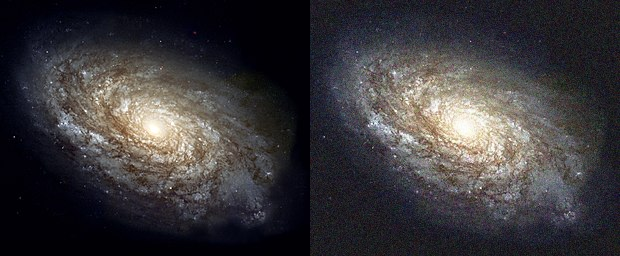

In [19]:
#No 3.1 (citra: 5)
import glob
from math import log10, sqrt

#membaca gambar ‘galaxy.jpg’ dari direktori
original = cv.imread('/content/drive/MyDrive/PCVK/Images/galaxy.jpg')
cv_img = []
#membaca semua gambar dari direktori yang memiliki ekstensi jpg dan disimpan dalam list cv_img
for img in glob.glob('/content/drive/MyDrive/PCVK/Images/noises/*.jpg'):
    n = cv.imread(img)
    cv_img.append(n)

#menginisialisasi variabel dst dengan gambar pertama dari list cv_img
dst = cv_img[0]
#melakukan loop sebanyak 4 kali
noise_number = 4 # nomor (array) gambar pada folder noises
for i in range(noise_number):
    if i == 0:
        pass
    else:
        alpha = 1.0 / (i + 1)
        beta = 1.0 - alpha
        #menghitung gambar hasil blending menggunakan rumus
        dst = cv.addWeighted(cv_img[i], alpha, dst, beta, 0.0)

#mendefinisikan fungsi PSNR()untuk menghitung nilai PSNR antara citra asli dan citra hasil blending
def PSNR(original, compressed):
    mse = np.mean((original - compressed) ** 2)
    if(mse == 0):  # MSE is zero means no noise is present in the signal.
                  # Therefore PSNR have no importance.
        return 100
    max_pixel = 255.0
    psnr = 20 * log10(max_pixel / sqrt(mse))
    return psnr

compressed = dst
psnr = PSNR(original, compressed)
#menampilkan nilai PSNR
print('Nilai PSNR adalah',psnr,'(dB)')
#menampilkan citra asli serta citra hasil blending secara horizontal menggunakan fungsi
galaxy_frame = cv.hconcat((original, dst))
cv2_imshow(galaxy_frame)

Nilai PSNR adalah 27.503329550502514 (dB)


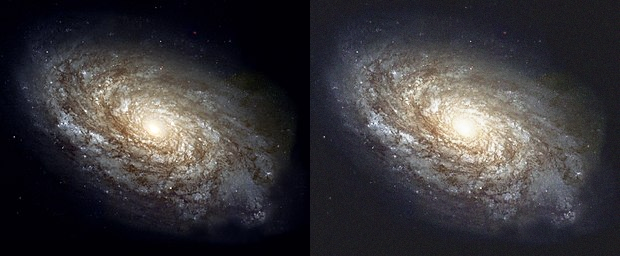

In [20]:
#No. 3.2 (citra: 30)

dst = cv_img[0]
noise_number = 29 # nomor (array) gambar pada folder noises
for i in range(noise_number):
    if i == 0:
        pass
    else:
        alpha = 1.0 / (i + 1)
        beta = 1.0 - alpha
        dst = cv.addWeighted(cv_img[i], alpha, dst, beta, 0.0)

compressed = dst
psnr = PSNR(original, compressed)

print('Nilai PSNR adalah',psnr,'(dB)')
galaxy_frame = cv.hconcat((original, dst))
cv2_imshow(galaxy_frame)

Nilai PSNR adalah 27.49950339364396 (dB)


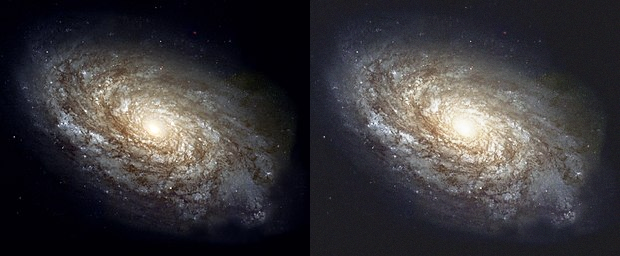

In [21]:
#No. 3.3 (citra: 60)

dst = cv_img[0]
noise_number = 59 # nomor (array) gambar pada folder noises
for i in range(noise_number):
    if i == 0:
        pass
    else:
        alpha = 1.0 / (i + 1)
        beta = 1.0 - alpha
        dst = cv.addWeighted(cv_img[i], alpha, dst, beta, 0.0)

compressed = dst
psnr = PSNR(original, compressed)

print('Nilai PSNR adalah',psnr,'(dB)')
galaxy_frame = cv.hconcat((original, dst))
cv2_imshow(galaxy_frame)

Nilai PSNR adalah 27.515248578271322 (dB)


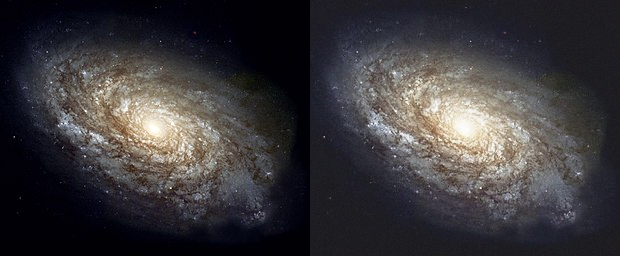

In [22]:
#No 3.5 (citra: 100)

dst = cv_img[0]
noise_number = 99 # nomor (array) gambar pada folder noises
for i in range(noise_number):
    if i == 0:
        pass
    else:
        alpha = 1.0 / (i + 1)
        beta = 1.0 - alpha
        dst = cv.addWeighted(cv_img[i], alpha, dst, beta, 0.0)

compressed = dst
psnr = PSNR(original, compressed)

print('Nilai PSNR adalah',psnr,'(dB)')
galaxy_frame = cv.hconcat((original, dst))
cv2_imshow(galaxy_frame)

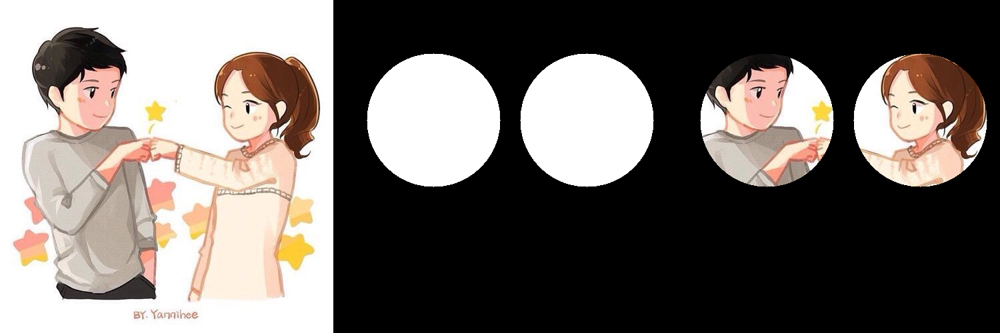

In [73]:
#No. 4

import cv2
import numpy as np

# Load the original image
couple_image = cv2.imread('/content/drive/MyDrive/PCVK/Images/couple.jpeg')

# Create a blank mask image
mask = np.zeros(couple_image.shape, dtype=np.uint8)

# Draw the first circle on the mask
mask = cv2.circle(mask, (150, 180), 100, (255,255,255), thickness=-1)  # White circle on black background

# Draw the second circle on the mask
mask1 = cv2.circle(mask, (380, 180), 100, (255,255,255), thickness=-1)  # White circle on black background

# Use the bitwise 'AND' operator to overlay the circles on the original image
result_image = couple_image & mask

# Display the result image
couple_frame = cv.hconcat([couple_image, mask, result_image])
cv2_imshow(couple_frame)




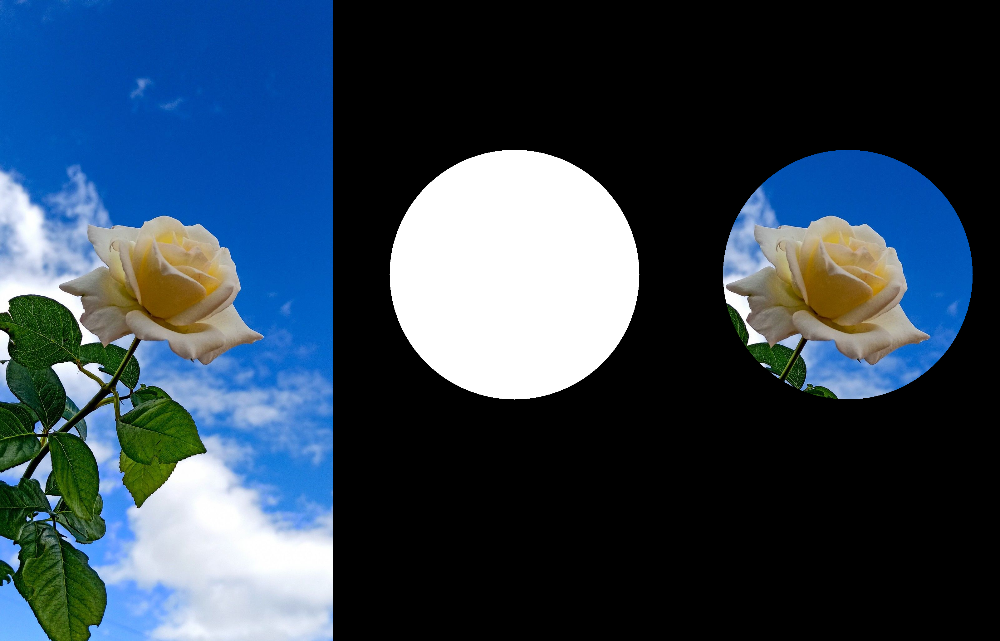

In [59]:
#Contoh Penggunaan Operator AND

img_rose = cv.imread('/content/drive/MyDrive/PCVK/Images/rose1.jpeg')

mask = np.zeros(img_rose.shape, dtype=np.uint8)
mask = cv.circle(mask, (580, 880), 400, (255,255,255), -1)

masked = img_rose & mask

rose_frame = cv.hconcat((img_rose, mask, masked))
cv2_imshow(rose_frame)

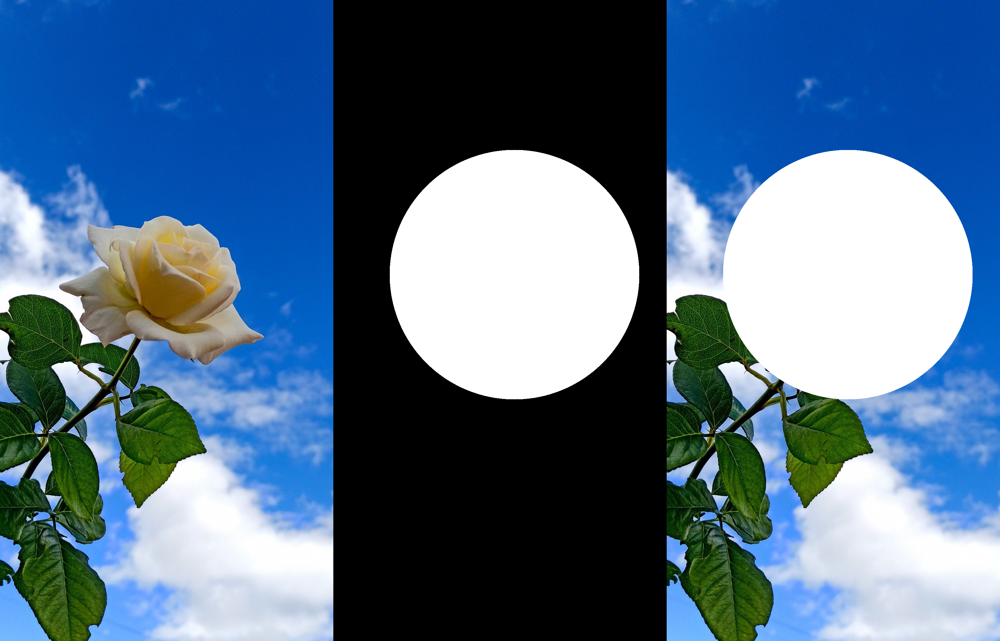

In [60]:
#No. 5.1 (OR)

mask = np.zeros(img_rose.shape, dtype=np.uint8)
mask = cv.circle(mask, (580, 880), 400, (255,255,255), -1)

masked = img_rose | mask

rose_frame = cv.hconcat((img_rose, mask, masked))
cv2_imshow(rose_frame)

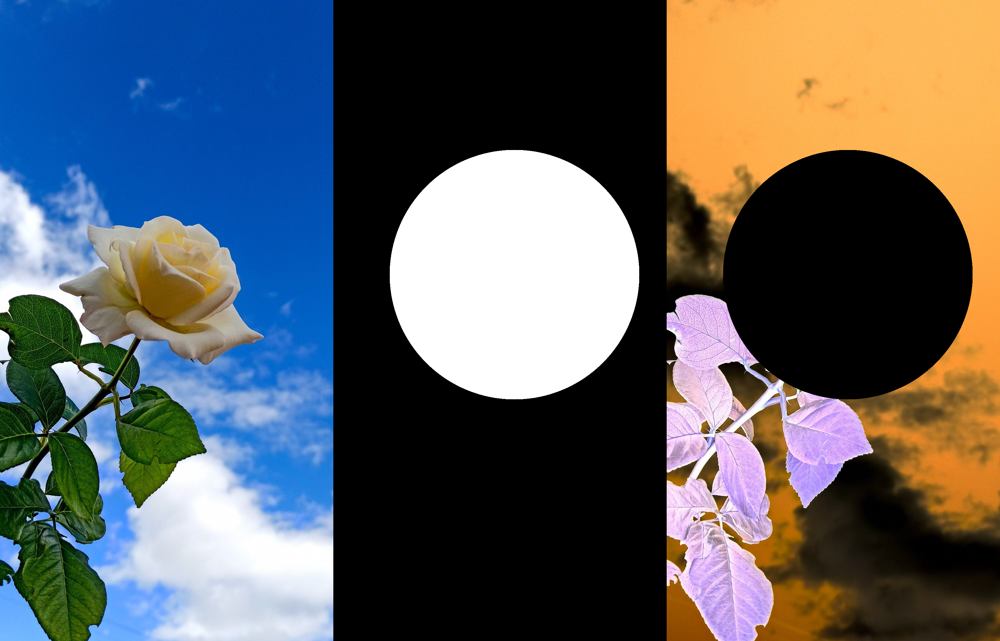

In [61]:
#No. 5.2 (NOT)

mask = np.zeros(img_rose.shape, dtype=np.uint8)
mask = cv.circle(mask, (580, 880), 400, (255,255,255), -1)

masked = ~img_rose & ~mask

rose_frame = cv.hconcat((img_rose, mask, masked))
cv2_imshow(rose_frame)

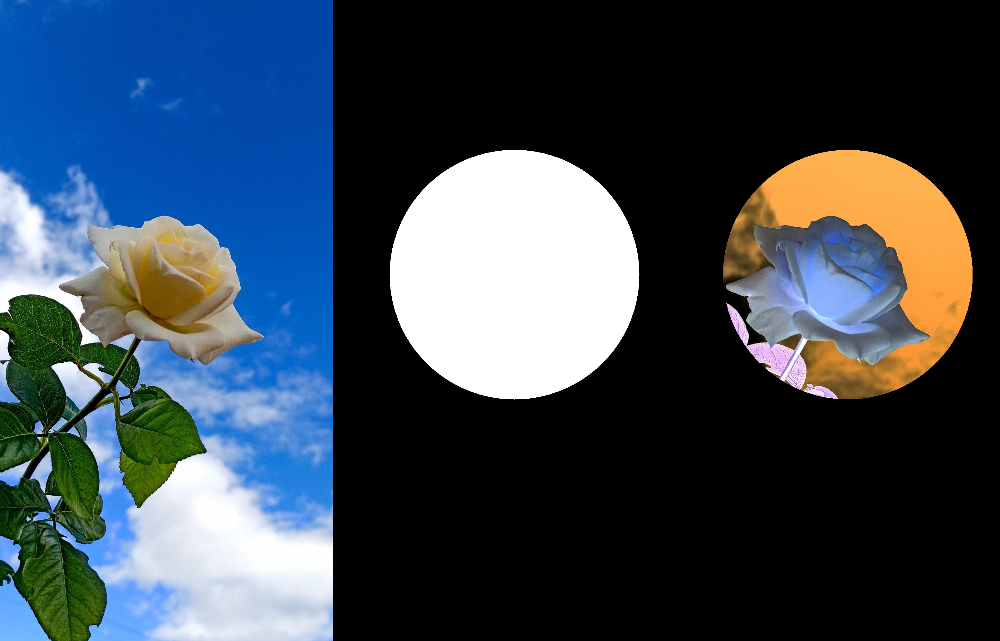

In [62]:
#No. 5.3 (NAND atau NOT AND)

mask = np.zeros(img_rose.shape, dtype=np.uint8)
mask = cv.circle(mask, (580, 880), 400, (255,255,255), -1)

masked = ~img_rose & mask

rose_frame = cv.hconcat((img_rose, mask, masked))
cv2_imshow(rose_frame)

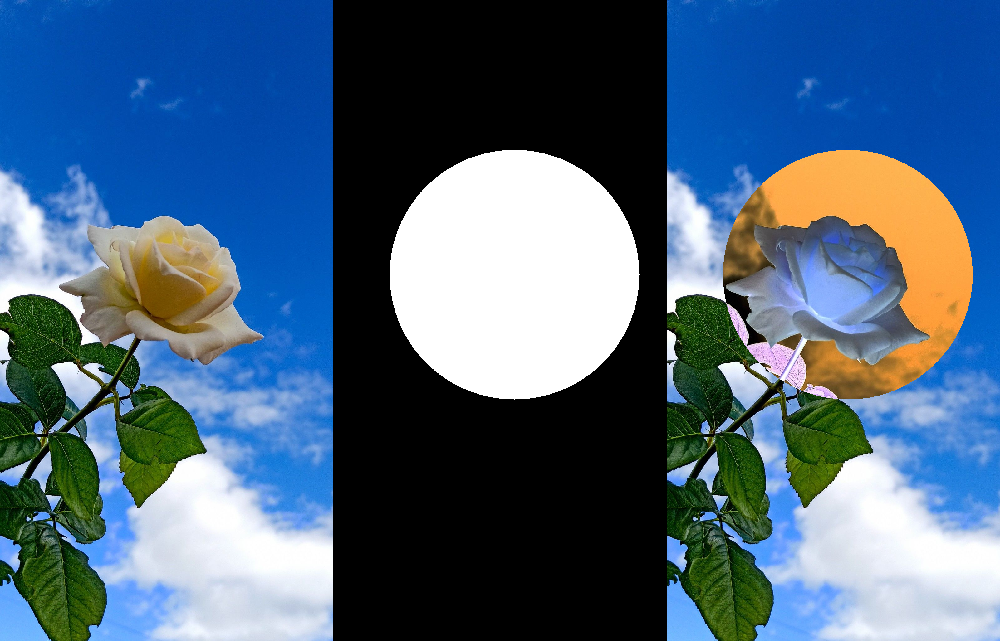

In [63]:
#No. 5.4 (XOR atau Exclusive OR)

mask = np.zeros(img_rose.shape, dtype=np.uint8)
mask = cv.circle(mask, (580, 880), 400, (255,255,255), -1)

masked = img_rose ^ mask

rose_frame = cv.hconcat((img_rose, mask, masked))
cv2_imshow(rose_frame)